### 4.1 회귀분석 예제

#### 보스턴 집값 예측

In [7]:
from sklearn.datasets import load_boston

boston = load_boston()
dir(boston) # dir명령어로 어떤 속성을가지고 있는지 확인

['DESCR', 'data', 'feature_names', 'filename', 'target']

In [6]:
# 데이터 프레임 형태로 생성
dfX = pd.DataFrame(boston.data, columns=boston.feature_names) # 분석 데이터(독립변수)
dfy = pd.DataFrame(boston.target, columns=['MEDV']) # 종속 변수

In [9]:
# 독립, 종속변수를 하나의 데이터프레임으로 묶어둠
df = pd.concat([dfX,dfy], axis = 1)

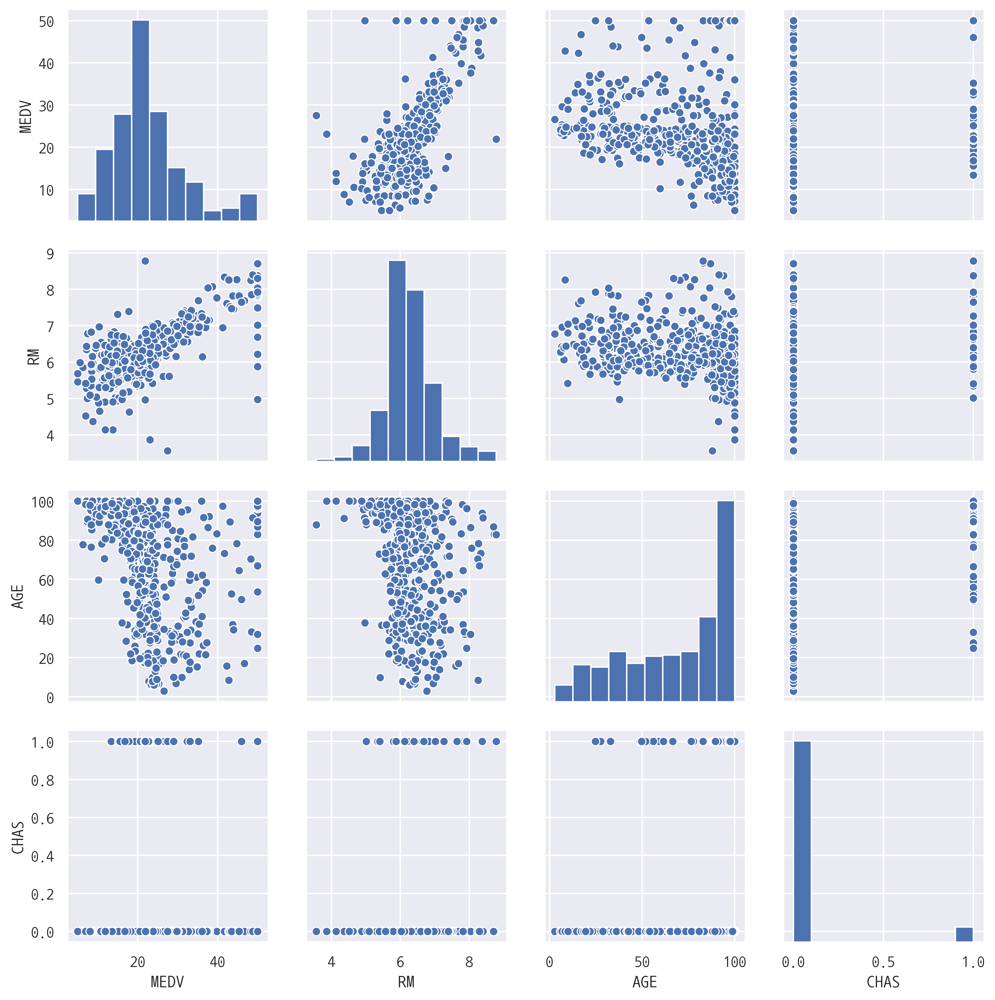

In [11]:
# 독립변수와 종속변수의 관계를 pairplot으로 확인
sns.pairplot(df[['MEDV', 'RM', 'AGE', 'CHAS']])
plt.show()

#### 당뇨병 진행도 예측

In [15]:
# 당뇨병 진행도 예측

from sklearn.datasets import load_diabetes

diabetes = load_diabetes()
df = pd.DataFrame(diabetes.data, columns=diabetes.feature_names)
df['target'] = diabetes.target
print(dir(diabetes))
df.tail()

['DESCR', 'data', 'data_filename', 'feature_names', 'target', 'target_filename']


,age,sex,bmi,bp,s1,s2,s3,s4,s5,s6,target
437,0.041708,0.050680,0.019662,0.059744,-0.005697,-0.002566,-0.028674,-0.002592,0.031193,0.007207,178.0
438,-0.005515,0.050680,-0.015906,-0.067642,0.049341,0.079165,-0.028674,0.034309,-0.018118,0.044485,104.0
439,0.041708,0.050680,-0.015906,0.017282,-0.037344,-0.013840,-0.024993,-0.011080,-0.046879,0.015491,132.0
440,-0.045472,-0.044642,0.039062,0.001215,0.016318,0.015283,-0.028674,0.026560,0.044528,-0.025930,220.0
441,-0.045472,-0.044642,-0.073030,-0.081414,0.083740,0.027809,0.173816,-0.039493,-0.004220,0.003064,57.0


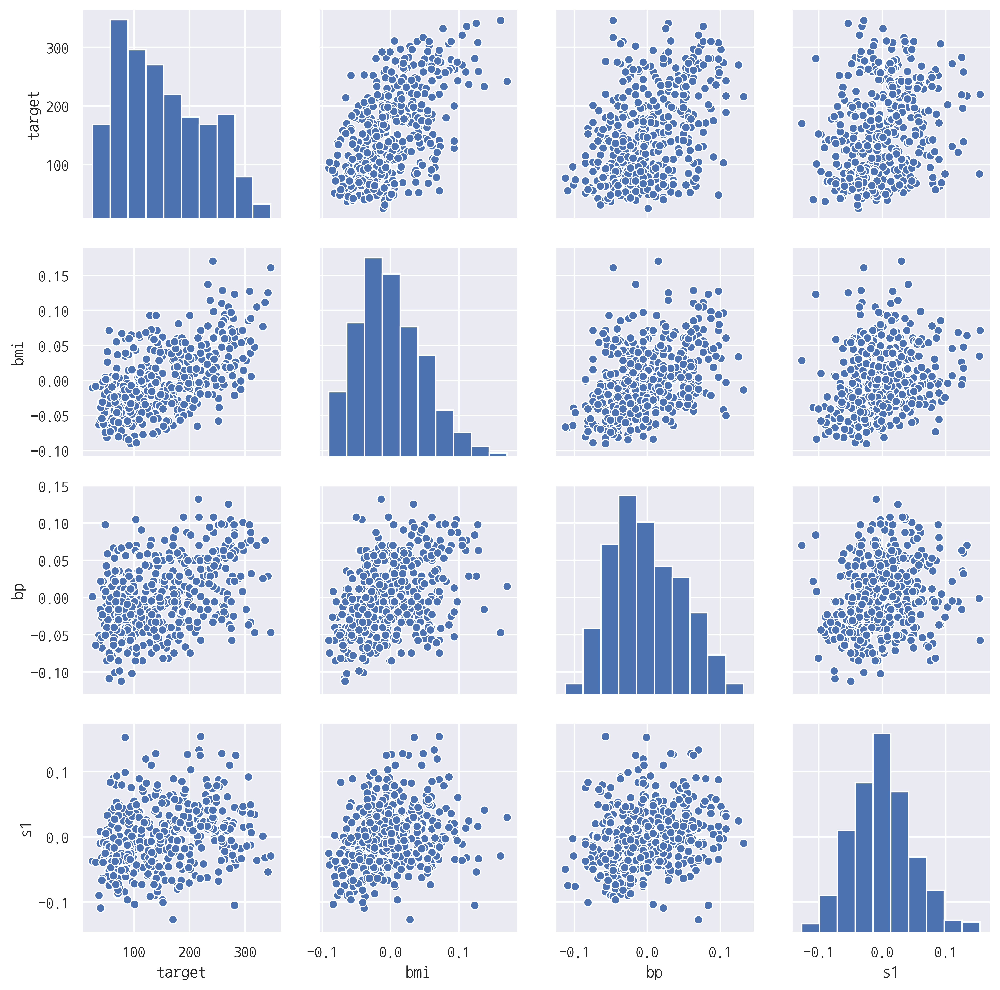

In [16]:
# pairplot 으로 데이터 확인
sns.pairplot(df[['target', 'bmi', 'bp', 's1']])
plt.show()

In [33]:
# 연습문제 4.1.1

from sklearn.datasets import fetch_california_housing
fetch = fetch_california_housing()
dir(fetch)
df_fetch = pd.DataFrame(fetch.data, columns=fetch.feature_names)
df_fetch['target'] = fetch.target
sns.pairplot(df_fetch[['target', 'MedInc', 'HouseAge', 'AveRooms',
                       'AveBedrms', 'Population', 'AveOccup', 'Latitude', 'Longitude']])
plt.show()

#### 가상데이터 예측

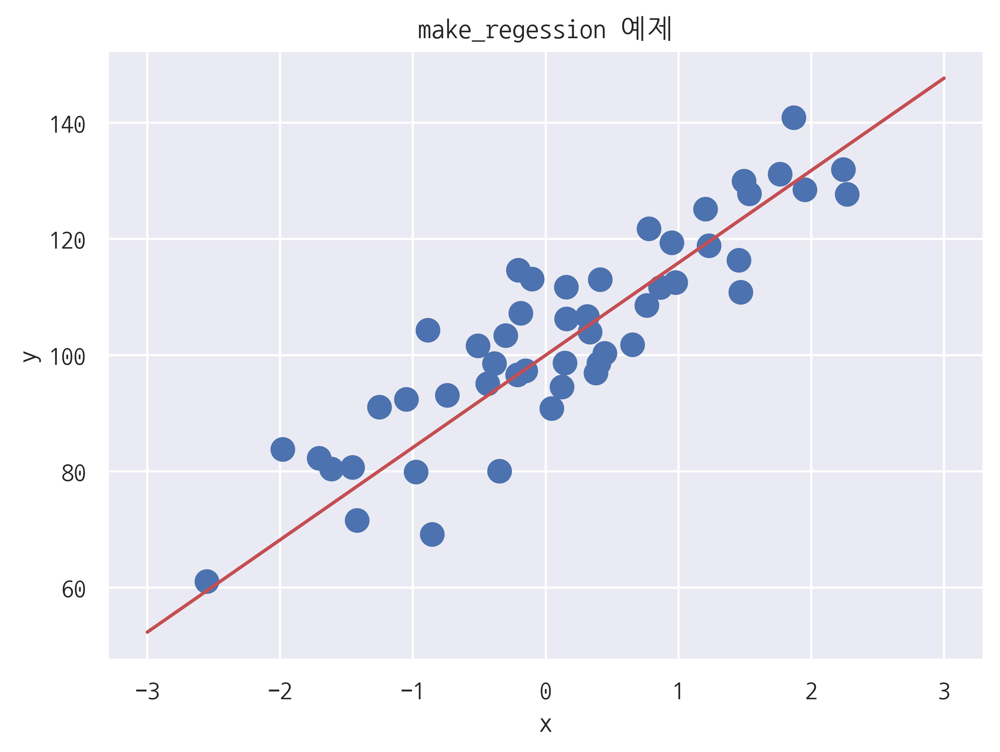

In [43]:
# 입력 : n_samples = 표본데이터의 갯수 , n_features= 독립변수의 수(차원),  bias= y의 기울기(x=0일때),
# noise= (잡음e의 표준편차), coef=True 면 선형모형의 계수(w)도 출력, random_state= 난수 발생용 시드값
# 출력 : X = [n_samples,n_features]의 독립변수 표본데이터 행렬, y = 종속변수표본 데이터 벡터, w 선형모형의 계수 벡터, coef = True일때만 출력
from sklearn.datasets import make_regression

X, y, w = make_regression(
    n_samples=50, n_features=1,  bias=100, noise=10, coef=True, random_state=0
)

xx = np.linspace(-3, 3, 100)
y0 = w * xx + 100
plt.plot(xx, y0, 'r-')
plt.scatter(X, y, s=100)
plt.xlabel('x')
plt.ylabel('y')
plt.title('make_regession 예제')
plt.show()

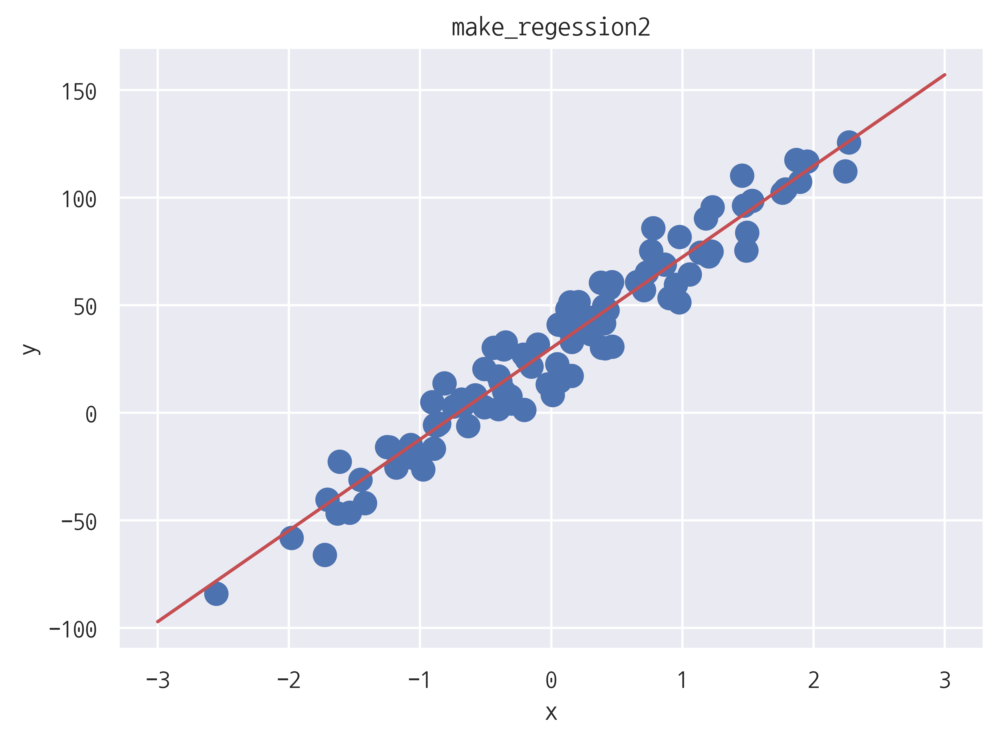

In [49]:
# 연습문제 4.1.2
X, y, w = make_regression(n_samples=100, n_features=1, bias=30, noise=10, random_state=0, coef=True)

xx = np.linspace(-3, 3, 100)
y0 = w * xx + 30
plt.plot(xx, y0, 'r-')
plt.scatter(X, y, s=100)
plt.xlabel('x')
plt.ylabel('y')
plt.title('make_regession2')
plt.show()

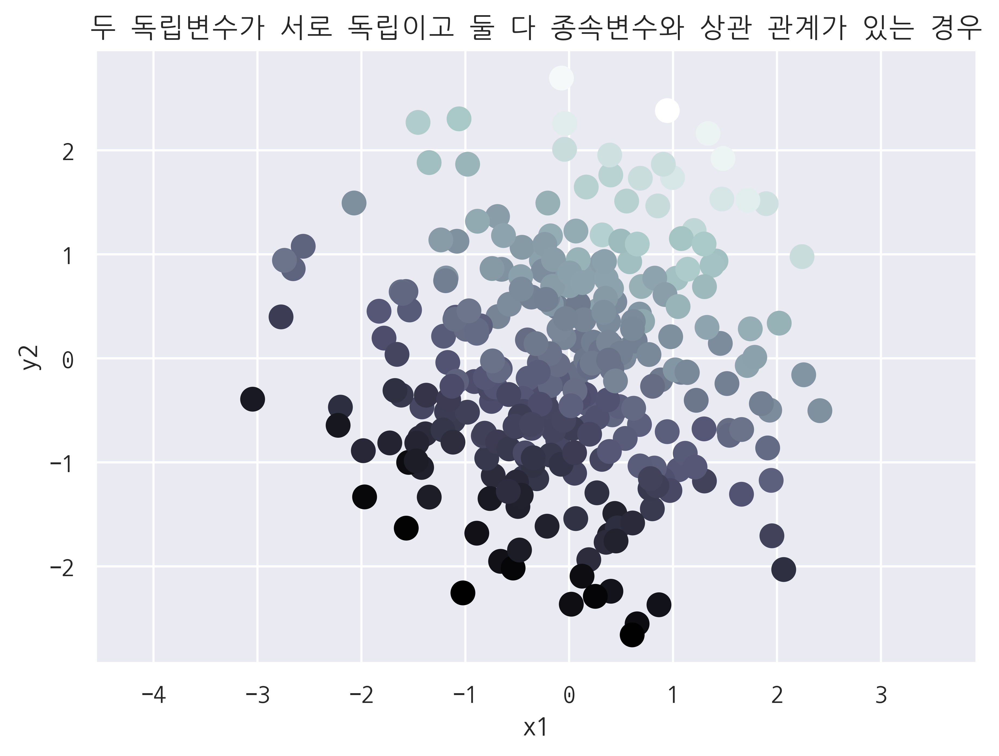

In [52]:
X, y, w = make_regression(
    n_samples=300, n_features=2, noise=10, coef=True, random_state=0
)

plt.scatter(X[:,0], X[:,1], c=y, s=100, cmap=mpl.cm.bone)
plt.xlabel('x1')
plt.ylabel('y2')
plt.axis('equal')
plt.title('두 독립변수가 서로 독립이고 둘 다 종속변수와 상관 관계가 있는 경우')
plt.show()

In [53]:
# make_regression 그외 명령
# n_informative : 독립 변수 중 실제로 종속변수와 상관관계가 있는 독립변수의 차원
# effective_rank : 독립변수 중 서로 독립인 독립변수의 수, None이면 모두 독립
# tail_strength : effective_rank가 None이 아닌경우 독립변수간의 상관관계를 결정하는 변수. 0.5면 독립변수간의 상관관계가 없다.

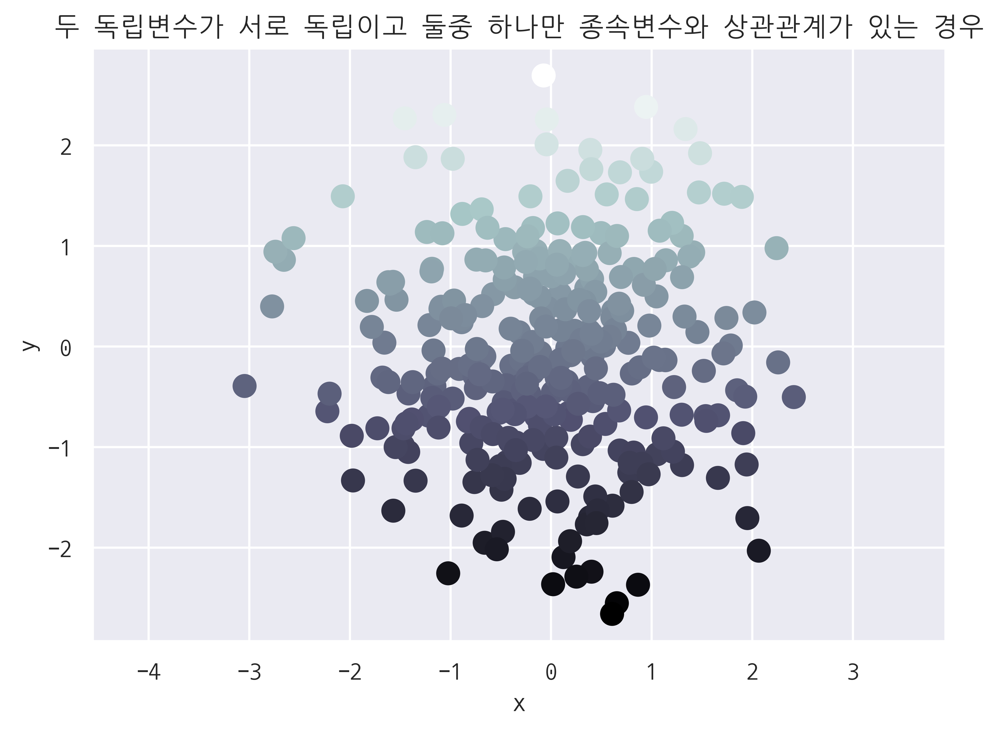

In [54]:
# 두 독립변수가 서로 독립이고 둘중 하나만 종속변수와 상관관계가 있는 경우
X, y, w = make_regression(
    n_samples=300, n_features=2, n_informative=1, noise=0, coef=True, random_state=0
)
plt.scatter(X[:,0], X[:,1], c=y, s=100, cmap=mpl.cm.bone)
plt.xlabel('x')
plt.ylabel('y')
plt.axis('equal')
plt.title('두 독립변수가 서로 독립이고 둘중 하나만 종속변수와 상관관계가 있는 경우')
plt.show()

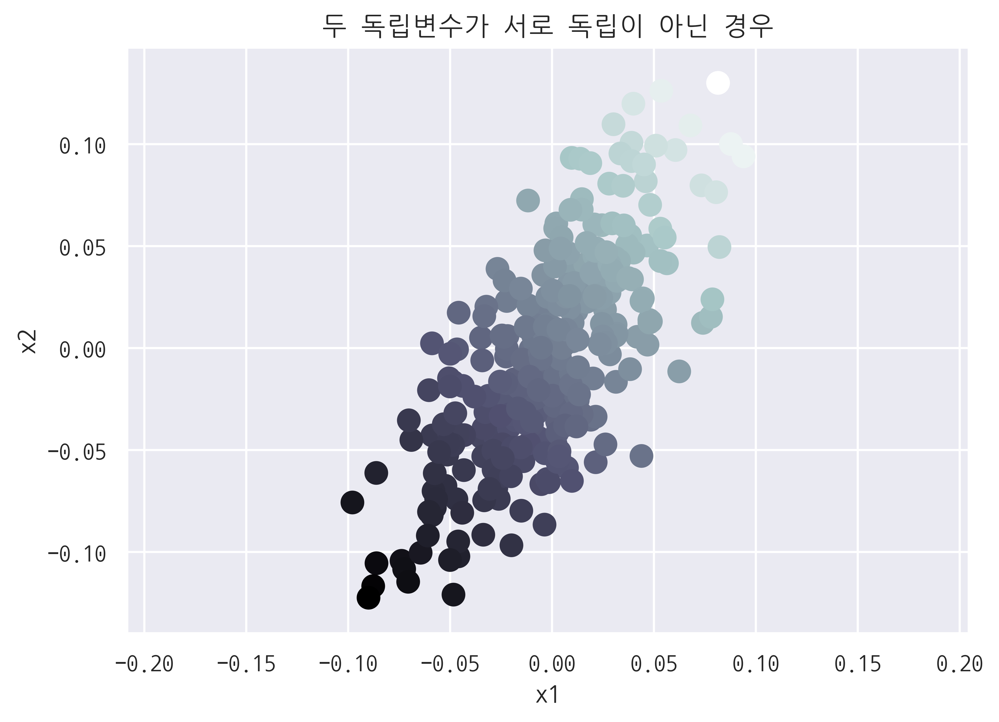

In [55]:
# 두 독립변수가 서로 독립이 아니고, 상관관계를 가지는 다중 공선성의 데이터
# tail_strength를 0에 가까운 작은값으로 설정

X, y, w = make_regression(n_samples=300, n_features=2, effective_rank=1,
                          noise=0, coef=True, random_state=0, tail_strength=0)
plt.scatter(X[:,0], X[:,1], c=y, s=100, cmap=mpl.cm.bone)
plt.xlabel('x1')
plt.ylabel('x2')
plt.axis('equal')
plt.title('두 독립변수가 서로 독립이 아닌 경우')
plt.show()

### 4.2 선형회귀분석의 기초

#### 상수항 결합

In [57]:
# statsmodels 의 add_constant 함수를 사용
import statsmodels.api as sm

In [58]:
X0 = np.arange(10).reshape(5, 2)
X0

array([[0, 1],
       [2, 3],
       [4, 5],
       [6, 7],
       [8, 9]])

In [60]:
# add_constant 함수로 X0 데이터에 앞에 1의 상수항을 결합시킨 X를 만듬
X = sm.add_constant(X0)
X

array([[1., 0., 1.],
       [1., 2., 3.],
       [1., 4., 5.],
       [1., 6., 7.],
       [1., 8., 9.]])

#### 최소 자승법

#### 직교방정식

#### NumPy를 이용한 선형 회귀분석

In [63]:
# make_regression을 사용하여 선형모형 생성
bias = 100
X0, y, w = make_regression(n_samples=200, n_features=1,
                           bias=bias, noise=10, coef=True, random_state=1)
X = sm.add_constant(X0) # 상수항 결합
y = y.reshape(len(y),1)
w #가중치 벡터, 모수값, 최소자승의 해

array(86.44794301)

y = 100 + 86.44794301x+ e

In [65]:
# OLS해를 직접 이용하여 구하기 (최소 자승)
# 잔차 e 때문에 정확하기 않음.
w = np.linalg.inv(X.T @ X) @ X.T @ y
w

array([[99.79150869],
       [86.96171201]])

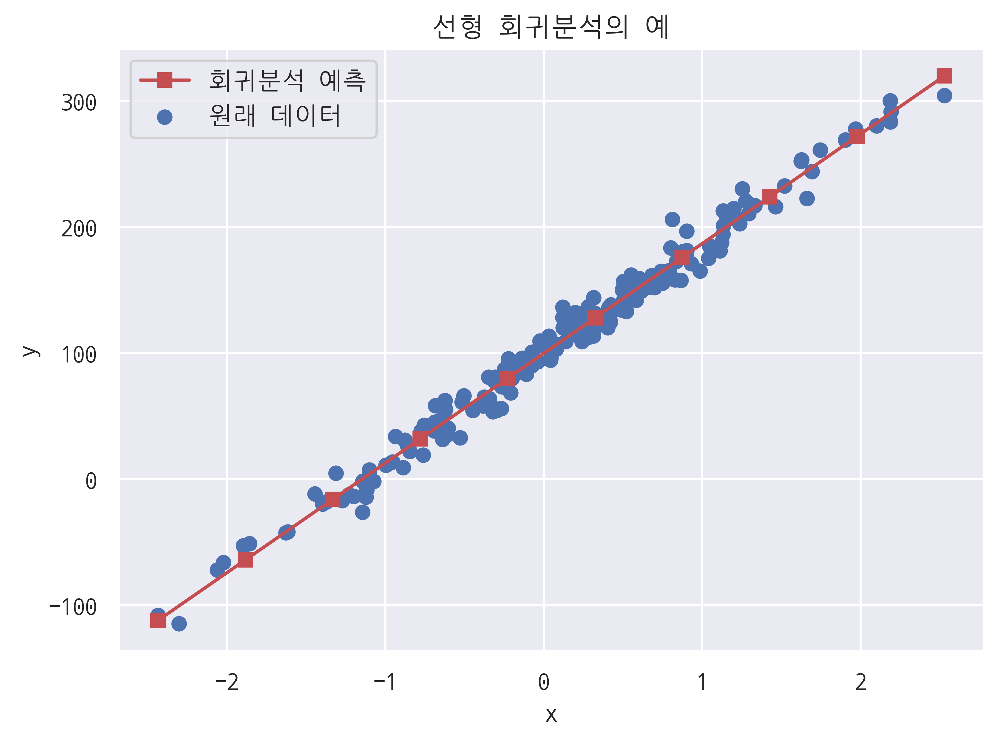

In [66]:
x_new = np.linspace(np.min(X0), np.max(X0), 10)
X_new = sm.add_constant(x_new)  # 상수항 결합
y_new = np.dot(X_new, w)

plt.scatter(X0, y, label="원래 데이터")
plt.plot(x_new, y_new, 'rs-', label="회귀분석 예측")
plt.xlabel("x")
plt.ylabel("y")
plt.title("선형 회귀분석의 예")
plt.legend()
plt.show()

#### scikit-learn 패키지를 사용한 선형회귀 분석

In [80]:
# 예제로 확인
from sklearn import linear_model
# LinearRegression클래스 객체 생성
model = linear_model.LinearRegression(fit_intercept=True)
# fit 메서드로 가중치 값을 추정
model = model.fit(X0,y)
print(model.intercept_, model.coef_)
# predit 메서드로 새로운 입력 데이터의 대한 출력 데이터 예측
model.predict([[-2],[-1],[0],[1],[2]])

[99.79150869] [[86.96171201]]


array([[-74.13191534],
       [ 12.82979668],
       [ 99.79150869],
       [186.7532207 ],
       [273.71493272]])

#### statsmodels 패키지를 사용한 선형 회귀분석

In [81]:
# 독립변수와 종속변수가 모두 포함된 데이터프레임 생성. 상수항 결합은 하지 않아도 됨
# 독립변수만 있는 데이터 프레임 dfx와 종속변수만 있는 데이터프레임 dfy를 인수로 넣어서 만들수도 있음.
# 다만 dfx에 상수항이 있어야 함.
# fit 메서드로 모형 추정, RegressionResults에 클래스 객체로 출력
# RegressionResults 클래스 객체는 결과 리포트용 summary 메서드와 예측을 위한 prediction메서드를 제공

In [83]:
# 예제로 확인
df = pd.DataFrame({'x':X0[:,0],'y':y[:,0]})
df

,x,y
0,0.232495,127.879017
1,-0.038696,93.032914
2,0.550537,161.857508
3,0.503185,141.692050
4,2.186980,283.260119
...,...,...
195,-0.172428,87.874277
196,-1.199268,-13.626664
197,1.462108,216.106619
198,1.131629,212.743149


In [91]:
# 모델 객체 생성
dfy = df[["y"]]
dfX = sm.add_constant(df[["x"]])
model = sm.OLS(dfy, dfX)
result = model.fit()
print(result.summary())

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.985
Model:                            OLS   Adj. R-squared:                  0.985
Method:                 Least Squares   F-statistic:                 1.278e+04
Date:                Mon, 24 Feb 2020   Prob (F-statistic):          8.17e-182
Time:                        15:24:46   Log-Likelihood:                -741.28
No. Observations:                 200   AIC:                             1487.
Df Residuals:                     198   BIC:                             1493.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         99.7915      0.705    141.592      0.0

In [94]:
# formula 문자열을 사용하여 모형 만들기
# formula = 종속변수 ~ 독립변수('y~x')
model = sm.OLS.from_formula('y~x',data =df)
result = model.fit()
print(result.summary())

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.985
Model:                            OLS   Adj. R-squared:                  0.985
Method:                 Least Squares   F-statistic:                 1.278e+04
Date:                Mon, 24 Feb 2020   Prob (F-statistic):          8.17e-182
Time:                        15:26:05   Log-Likelihood:                -741.28
No. Observations:                 200   AIC:                             1487.
Df Residuals:                     198   BIC:                             1493.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept     99.7915      0.705    141.592      0.0

In [95]:
# predict 메서드로 새로운값에 대응하는 y값 예측
result.predict({'x': [-2, -1, 0, 1, 2]})

0    -74.131915
1     12.829797
2     99.791509
3    186.753221
4    273.714933
dtype: float64

Intercept    99.791509
x            86.961712
dtype: float64


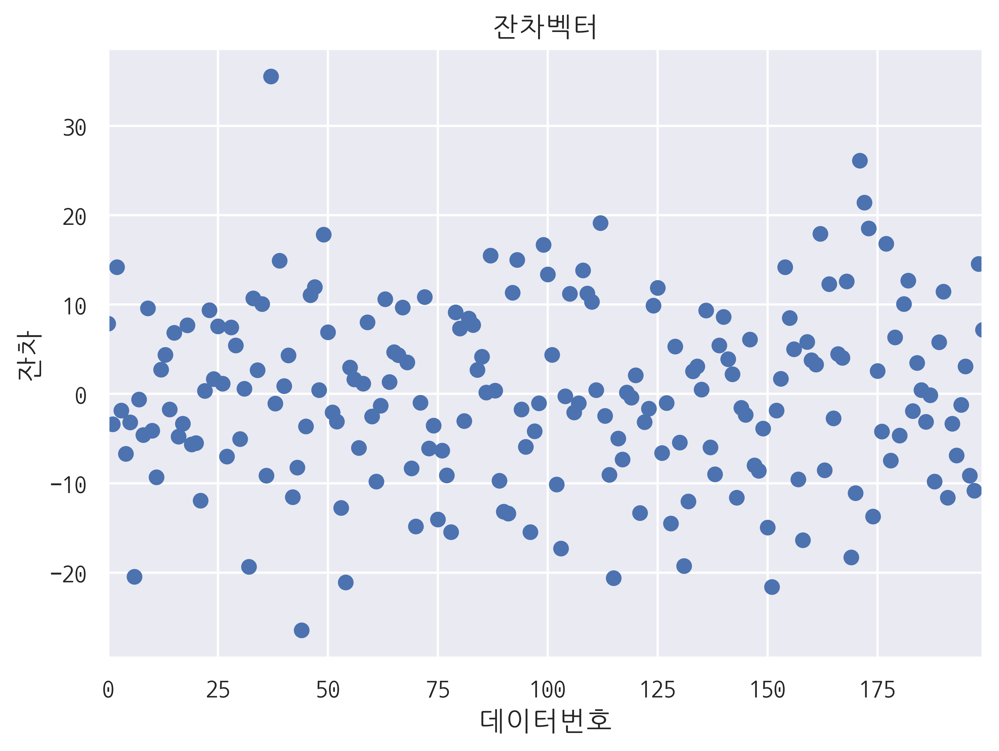

In [98]:
# Regression 분석결과를 다양한 속성에 저장
# params : 가중치 벡터
print(result.params)
# resid : 잔체 벡터
result.resid.plot(style='o')
plt.title('잔차벡터')
plt.xlabel('데이터번호')
plt.ylabel('잔차')
plt.show()

In [101]:
# 직교방정식 : 잔차 벡터의 합은 0 
result.resid.sum()

3.7196912217041245e-12

In [105]:
# x의 평균값을 넣으면 y의 평균값
print(result.predict({'x':X0.mean()}))
print(y.mean())

0    109.069351
dtype: float64
109.06935068170773


#### 보스턴 집값 예측

In [109]:
from sklearn.datasets import load_boston
boston = load_boston()
dfX0 = pd.DataFrame(boston.data, columns=boston.feature_names) # 보스턴 집값 데이터를 df로 만듬
dfX = sm.add_constant(dfX0) # 상수항 벡터 생성
dfy = pd.DataFrame(boston.target, columns=['MEDV']) # 타겟(y)를 df로 만듬

model_boston2 = sm.OLS(dfy, dfX)
result_boston2 = model_boston2.fit()
print(result_boston2.summary())

                            OLS Regression Results                            
Dep. Variable:                   MEDV   R-squared:                       0.741
Model:                            OLS   Adj. R-squared:                  0.734
Method:                 Least Squares   F-statistic:                     108.1
Date:                Mon, 24 Feb 2020   Prob (F-statistic):          6.72e-135
Time:                        15:33:43   Log-Likelihood:                -1498.8
No. Observations:                 506   AIC:                             3026.
Df Residuals:                     492   BIC:                             3085.
Df Model:                          13                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         36.4595      5.103      7.144      0.0

In [117]:
# 연습문제 4.1.3
# 당뇨병 진행도 예측

from sklearn.datasets import load_diabetes

diabetes = load_diabetes()
dfX0 = pd.DataFrame(diabetes.data, columns=diabetes.feature_names)
dfX = sm.add_constant(dfX0)
dfy =  pd.DataFrame(diabetes.target, columns=['target'])

model_diabetes = sm.OLS(dfy,dfX)
result_diabetes = model_diabetes.fit()
print(result_diabetes.summary())

                            OLS Regression Results                            
Dep. Variable:                 target   R-squared:                       0.518
Model:                            OLS   Adj. R-squared:                  0.507
Method:                 Least Squares   F-statistic:                     46.27
Date:                Mon, 24 Feb 2020   Prob (F-statistic):           3.83e-62
Time:                        15:38:53   Log-Likelihood:                -2386.0
No. Observations:                 442   AIC:                             4794.
Df Residuals:                     431   BIC:                             4839.
Df Model:                          10                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const        152.1335      2.576     59.061      0.0